原始网络的适应度值: 561.5286145749088


Population=300:   0%|          | 0/120 [00:00<?, ?it/s]

总边权重: 383.0121251944414，总跳数: 738，适应度值: 560.5060625972208
总边权重: 382.9700016492588，总跳数: 738，适应度值: 560.4850008246294
总边权重: 382.3925182816299，总跳数: 735，适应度值: 558.696259140815
总边权重: 382.7139794457199，总跳数: 730，适应度值: 556.3569897228599
总边权重: 382.70410113199046，总跳数: 735，适应度值: 558.8520505659952
总边权重: 382.63546395037366，总跳数: 734，适应度值: 558.3177319751868
总边权重: 382.65642724584023，总跳数: 736，适应度值: 559.3282136229201
总边权重: 382.45022799744834，总跳数: 735，适应度值: 558.7251139987242
总边权重: 375.482901773191，总跳数: 770，适应度值: 572.7414508865954
总边权重: 382.57523567449306，总跳数: 738，适应度值: 560.2876178372466
总边权重: 382.71871134968296，总跳数: 736，适应度值: 559.3593556748415
总边权重: 380.97013223452643，总跳数: 744，适应度值: 562.4850661172632
总边权重: 381.69501031871266，总跳数: 737，适应度值: 559.3475051593564
总边权重: 382.63546395037366，总跳数: 734，适应度值: 558.3177319751868
总边权重: 382.7000165523232，总跳数: 731，适应度值: 556.8500082761616
总边权重: 386.27935633690385，总跳数: 729，适应度值: 557.639678168452
总边权重: 380.0218963330642，总跳数: 725，适应度值: 552.5109481665321
总边权重: 381.66023341572276

/home/huanghanjun/anaconda3/envs/graph-tool/lib/python3.12/site-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


总边权重: 371.80979967561694，总跳数: 715，适应度值: 543.4048998378084
总边权重: inf，总跳数: 637，适应度值: inf
总边权重: 381.6047156782544，总跳数: 720，适应度值: 550.8023578391272
总边权重: 377.8475515698119，总跳数: 720，适应度值: 548.923775784906
总边权重: 376.56042062023056，总跳数: 719，适应度值: 547.7802103101153
总边权重: 371.2839707106733，总跳数: 714，适应度值: 542.6419853553366
总边权重: 381.21225371612667，总跳数: 732，适应度值: 556.6061268580634
总边权重: 381.4975454264519，总跳数: 719，适应度值: 550.2487727132259
总边权重: 375.89002311103354，总跳数: 704，适应度值: 539.9450115555168
总边权重: 377.9317974391224，总跳数: 719，适应度值: 548.4658987195612
总边权重: 383.13645980353726，总跳数: 718，适应度值: 550.5682299017686
总边权重: 380.31703973151616，总跳数: 726，适应度值: 553.1585198657581
总边权重: 377.8475515698119，总跳数: 720，适应度值: 548.923775784906
总边权重: 382.54822144458944，总跳数: 707，适应度值: 544.7741107222947
总边权重: 370.8661180513417，总跳数: 729，适应度值: 549.9330590256709
总边权重: 376.51129871008965，总跳数: 727，适应度值: 551.7556493550449
总边权重: 366.6908053611786，总跳数: 716，适应度值: 541.3454026805894
总边权重: 371.26422346502966，总跳数: 723，适应度值: 547.132111732

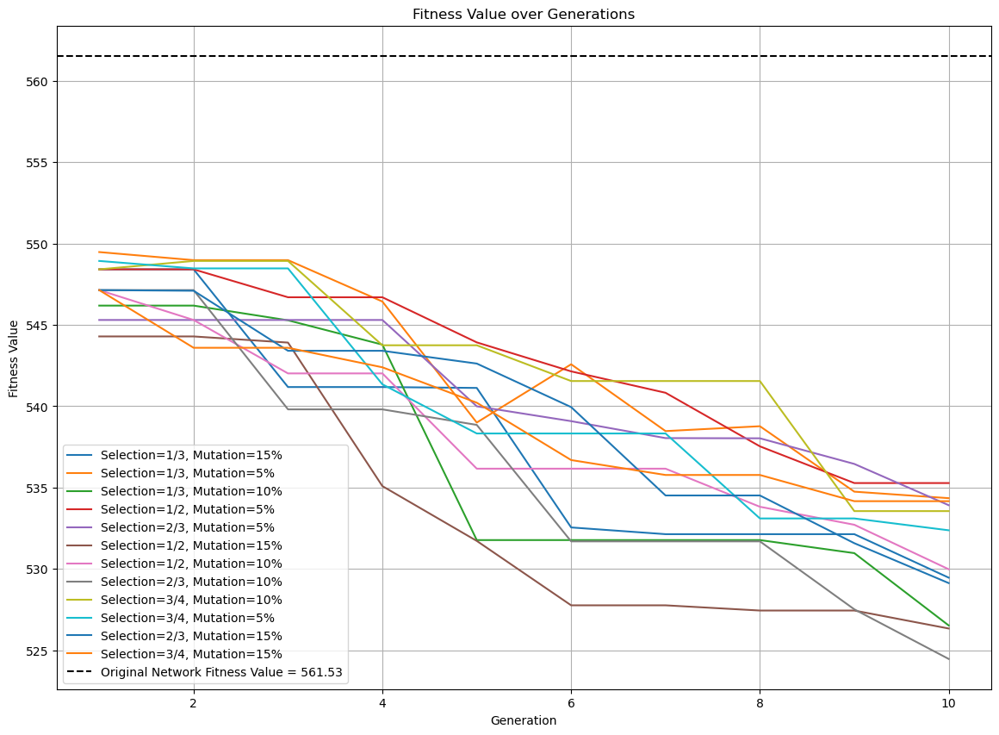

图像已保存到: ./output/plots/re5ATT_US_Norm_fitness_plot.png


In [1]:
import numpy as np
from graph_tool.all import Graph, shortest_distance, shortest_path, all_shortest_paths
from deap import base, creator, tools, algorithms
import python_codes.files_operators as fo
import matplotlib.pyplot as plt
from concurrent.futures import ThreadPoolExecutor, as_completed
from fractions import Fraction
from tqdm.notebook import tqdm
import os
import python_codes.ga_utils as ga  # 调整后的导入路径

# 读取图和位置信息
filename1 = "ATT_US_Norm"
read_graph, read_pos = fo.read_files(f"../networks_clusters/{filename1}.net")
num_edges = read_graph.num_edges()

# 计算并添加边的欧几里得距离作为权重属性
edge_weights = read_graph.new_edge_property("double")
for edge in read_graph.edges():
    source_pos = read_pos[edge.source()]
    target_pos = read_pos[edge.target()]
    euclidean_distance = np.sqrt((source_pos[0] - target_pos[0]) ** 2 + (source_pos[1] - target_pos[1]) ** 2)
    edge_weights[edge] = euclidean_distance

# 计算原始网络的最短路径和
dist_matrix = shortest_distance(read_graph, weights=edge_weights).get_2d_array(range(read_graph.num_vertices()))
original_total_distance = np.sum(dist_matrix[dist_matrix != np.inf])

# 使用 all_shortest_paths 计算原始网络的跳数
original_total_hops = 0
num_vertices = read_graph.num_vertices()

for source in range(num_vertices):
    for target in range(source + 1, num_vertices):
        if dist_matrix[source][target] != np.inf:  # 确保节点对可达
            for path in all_shortest_paths(read_graph, source, target, weights=edge_weights):
                original_total_hops += len(path) - 1  # 计算跳数
                break  # 只取一个最短路径

# 设置适应度权重
weight_distance = 0.5  # 最短路径权重
weight_hops = 1.0 - weight_distance  # 跳数权重
original_fitness_value = weight_distance * original_total_distance + weight_hops * original_total_hops

print(f"原始网络的适应度值: {original_fitness_value}")


# 创建个体和适应度
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)

# 注册工具箱
toolbox = base.Toolbox()
toolbox.register("individual", ga.init_individual, read_graph=read_graph, edge_weights=edge_weights,
                 num_edges=num_edges)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)
toolbox.register("evaluate", ga.evaluate, read_graph=read_graph, read_pos=read_pos, edge_weights=edge_weights)

# 自定义交叉和变异操作
toolbox.register("mate", ga.cxGraph, num_edges=num_edges)
toolbox.register("mutate", ga.mutGraph, num_edges=num_edges)
toolbox.register("select", tools.selTournament, tournsize=3)


# 主遗传算法流程
def main(population_size, selection_ratio, mutpb, initial_population, pbar, num_generations):
    num_selected = int(population_size * selection_ratio)
    num_offspring = population_size - num_selected
    cxpb = 0.5
    pop = initial_population[:]
    hof = tools.HallOfFame(1)
    stats = tools.Statistics(lambda ind: ind.fitness.values)
    stats.register("min", np.min)
    logbook = tools.Logbook()
    logbook.header = ["gen", "min"]

    for gen in range(num_generations):
        selected = toolbox.select(pop, num_selected)
        offspring = algorithms.varAnd(selected, toolbox, cxpb, mutpb)
        offspring = offspring[:num_offspring]
        pop[:] = selected + offspring
        fitnesses = list(map(toolbox.evaluate, pop))
        for ind, fit in zip(pop, fitnesses):
            ind.fitness.values = fit
        record = stats.compile(pop)
        logbook.record(gen=gen, **record)
        pbar.update(1)
        hof.update(pop)

    return logbook, hof[0].fitness.values[0]


# 参数配置
num_generations = 10
population_sizes = [300]
selection_ratios = [1 / 3, 1 / 2, 2 / 3, 3 / 4]
mutation_probs = [0.05, 0.1, 0.15]
progress_bars = {
    pop_size: tqdm(total=12 * num_generations, desc=f'Population={pop_size}', position=i, leave=True)
    for i, pop_size in enumerate(population_sizes)
}

# 执行主流程
initial_population = toolbox.population(n=population_sizes[0])
fitnesses = list(map(toolbox.evaluate, initial_population))
initial_fitness = min(fitnesses)[0]
all_logbooks = []

# 执行每个种群大小的实验并绘图
for population_size in population_sizes:
    initial_population = toolbox.population(n=population_size)
    fitnesses = list(map(toolbox.evaluate, initial_population))
    initial_fitness = min(fitnesses)[0]

    with ThreadPoolExecutor(max_workers=4) as executor:
        future_to_params = {
            executor.submit(main, population_size, selection_ratio, mutpb, initial_population,
                            progress_bars[population_size], num_generations): (
                selection_ratio, mutpb)
            for selection_ratio in selection_ratios
            for mutpb in mutation_probs
        }

        for future in as_completed(future_to_params):
            selection_ratio, mutpb = future_to_params[future]
            try:
                logbook, final_fitness = future.result()
                all_logbooks.append((logbook, selection_ratio, mutpb))

                print(
                    f'Completed: Pop={population_size}, Select={selection_ratio}, Mutate={mutpb} - Final Fitness={final_fitness}')

            except Exception as ex:
                print(f'Error with Pop={population_size}, Select={selection_ratio}, Mutate={mutpb}: {ex}')

# 绘制适应度值随代数的变化图
plt.figure(figsize=(14, 10))
for logbook, selection_ratio, mutpb in all_logbooks:
    min_fitness_values = logbook.select("min")
    generations = list(range(1, len(min_fitness_values) + 1))
    fitness_values = [initial_fitness] + min_fitness_values
    generations = [0] + generations

    plt.plot(generations, fitness_values,
             label=f'Selection={Fraction(selection_ratio).limit_denominator()}, Mutation={int(mutpb * 100)}%')

# 在图表上添加原始网络的适应度值
plt.axhline(y=original_fitness_value, color='k', linestyle='--',
            label=f'Original Network Fitness Value = {original_fitness_value:.2f}')
plt.title("Fitness Value over Generations")
plt.xlabel("Generation")
plt.ylabel("Fitness Value")
plt.legend()
plt.grid(True)

# 保存生成的图表
output_dir = "./output/plots"
os.makedirs(output_dir, exist_ok=True)  # 确保输出目录存在
output_filename = os.path.join(output_dir, f"re5{filename1}_fitness_plot.png")
plt.savefig(output_filename)
plt.show()
print(f"图像已保存到: {output_filename}")


原始网络的适应度值: 561.5286145749088


/home/huanghanjun/anaconda3/envs/graph-tool/lib/python3.12/site-packages/deap/creator.py:185: RuntimeWarning: A class named 'FitnessMin' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
/home/huanghanjun/anaconda3/envs/graph-tool/lib/python3.12/site-packages/deap/creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


Population=300:   0%|          | 0/1200 [00:00<?, ?it/s]

总边权重: 382.96499255948436，总跳数: 734，适应度值: 558.4824962797422
总边权重: 381.4975454264519，总跳数: 719，适应度值: 550.2487727132259
总边权重: 382.7103269302105，总跳数: 733，适应度值: 557.8551634651053
总边权重: 383.48721012446254，总跳数: 737，适应度值: 560.2436050622313
总边权重: 382.1870518663577，总跳数: 736，适应度值: 559.0935259331789
总边权重: 382.4726971476067，总跳数: 735，适应度值: 558.7363485738033
总边权重: 388.0935013098651，总跳数: 724，适应度值: 556.0467506549326
总边权重: 382.1332464648583，总跳数: 728，适应度值: 555.0666232324292
总边权重: 383.0513190246961，总跳数: 738，适应度值: 560.525659512348
总边权重: 382.87516293135076，总跳数: 736，适应度值: 559.4375814656754
总边权重: 383.04737929265787，总跳数: 739，适应度值: 561.0236896463289
总边权重: 381.90677810054206，总跳数: 734，适应度值: 557.953389050271
总边权重: 382.89832931530265，总跳数: 736，适应度值: 559.4491646576513
总边权重: 381.9957723841849，总跳数: 734，适应度值: 557.9978861920924
总边权重: 382.35856114728807，总跳数: 735，适应度值: 558.6792805736441
总边权重: 383.0145691801121，总跳数: 737，适应度值: 560.0072845900561
总边权重: 380.84520140233366，总跳数: 722，适应度值: 551.4226007011669
总边权重: 382.2115158295476，总

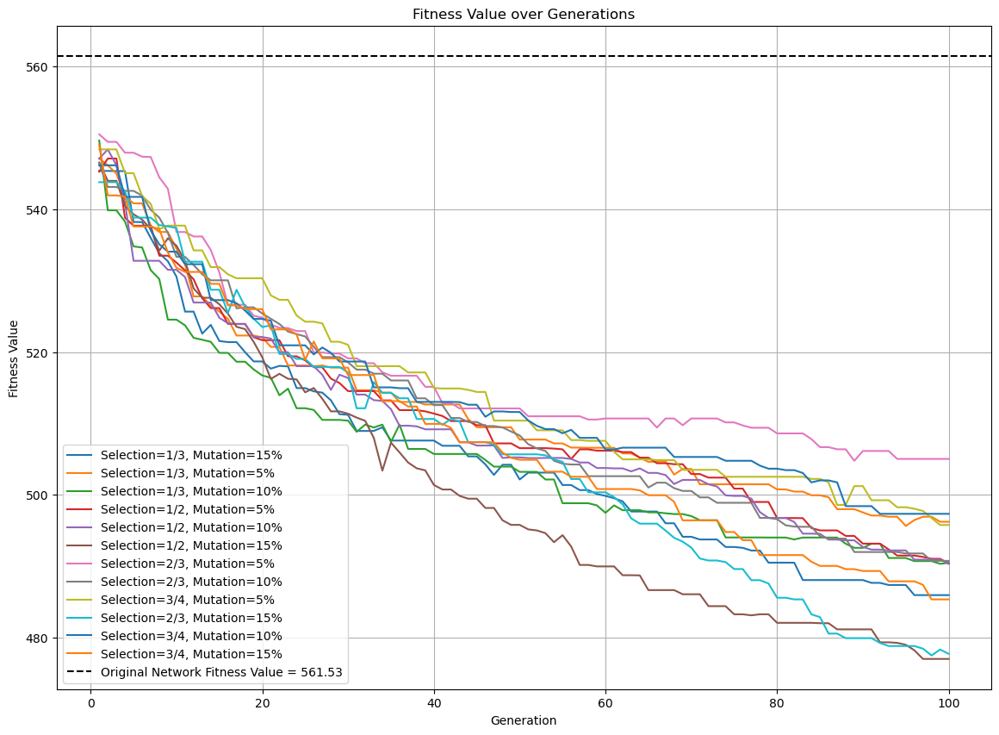

图像已保存到: ./output/plots/re100ATT_US_Norm_fitness_plot.png


In [2]:
import numpy as np
from graph_tool.all import Graph, shortest_distance, shortest_path, all_shortest_paths
from deap import base, creator, tools, algorithms
import python_codes.files_operators as fo
import matplotlib.pyplot as plt
from concurrent.futures import ThreadPoolExecutor, as_completed
from fractions import Fraction
from tqdm.notebook import tqdm
import os
import python_codes.ga_utils as ga  # 调整后的导入路径

# 读取图和位置信息
filename1 = "ATT_US_Norm"
read_graph, read_pos = fo.read_files(f"../networks_clusters/{filename1}.net")
num_edges = read_graph.num_edges()

# 计算并添加边的欧几里得距离作为权重属性
edge_weights = read_graph.new_edge_property("double")
for edge in read_graph.edges():
    source_pos = read_pos[edge.source()]
    target_pos = read_pos[edge.target()]
    euclidean_distance = np.sqrt((source_pos[0] - target_pos[0]) ** 2 + (source_pos[1] - target_pos[1]) ** 2)
    edge_weights[edge] = euclidean_distance

# 计算原始网络的最短路径和
dist_matrix = shortest_distance(read_graph, weights=edge_weights).get_2d_array(range(read_graph.num_vertices()))
original_total_distance = np.sum(dist_matrix[dist_matrix != np.inf])

# 使用 all_shortest_paths 计算原始网络的跳数
original_total_hops = 0
num_vertices = read_graph.num_vertices()

for source in range(num_vertices):
    for target in range(source + 1, num_vertices):
        if dist_matrix[source][target] != np.inf:  # 确保节点对可达
            for path in all_shortest_paths(read_graph, source, target, weights=edge_weights):
                original_total_hops += len(path) - 1  # 计算跳数
                break  # 只取一个最短路径

# 设置适应度权重
weight_distance = 0.5  # 最短路径权重
weight_hops = 1.0 - weight_distance  # 跳数权重
original_fitness_value = weight_distance * original_total_distance + weight_hops * original_total_hops

print(f"原始网络的适应度值: {original_fitness_value}")

# 创建个体和适应度
creator.create("FitnessMin", base.Fitness, weights=(-1.0,))
creator.create("Individual", list, fitness=creator.FitnessMin)

# 注册工具箱
toolbox = base.Toolbox()
toolbox.register("individual", ga.init_individual, read_graph=read_graph, edge_weights=edge_weights,
                 num_edges=num_edges)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)
toolbox.register("evaluate", ga.evaluate, read_graph=read_graph, read_pos=read_pos, edge_weights=edge_weights)

# 自定义交叉和变异操作
toolbox.register("mate", ga.cxGraph, num_edges=num_edges)
toolbox.register("mutate", ga.mutGraph, num_edges=num_edges)
toolbox.register("select", tools.selTournament, tournsize=3)


# 主遗传算法流程
def main(population_size, selection_ratio, mutpb, initial_population, pbar, num_generations):
    num_selected = int(population_size * selection_ratio)
    num_offspring = population_size - num_selected
    cxpb = 0.5
    pop = initial_population[:]
    hof = tools.HallOfFame(1)
    stats = tools.Statistics(lambda ind: ind.fitness.values)
    stats.register("min", np.min)
    logbook = tools.Logbook()
    logbook.header = ["gen", "min"]

    for gen in range(num_generations):
        selected = toolbox.select(pop, num_selected)
        offspring = algorithms.varAnd(selected, toolbox, cxpb, mutpb)
        offspring = offspring[:num_offspring]
        pop[:] = selected + offspring
        fitnesses = list(map(toolbox.evaluate, pop))
        for ind, fit in zip(pop, fitnesses):
            ind.fitness.values = fit
        record = stats.compile(pop)
        logbook.record(gen=gen, **record)
        pbar.update(1)
        hof.update(pop)

    return logbook, hof[0].fitness.values[0]


# 参数配置
num_generations = 100
population_sizes = [300]
selection_ratios = [1 / 3, 1 / 2, 2 / 3, 3 / 4]
mutation_probs = [0.05, 0.1, 0.15]
progress_bars = {
    pop_size: tqdm(total=12 * num_generations, desc=f'Population={pop_size}', position=i, leave=True)
    for i, pop_size in enumerate(population_sizes)
}

# 执行主流程
initial_population = toolbox.population(n=population_sizes[0])
fitnesses = list(map(toolbox.evaluate, initial_population))
initial_fitness = min(fitnesses)[0]
all_logbooks = []

# 执行每个种群大小的实验并绘图
for population_size in population_sizes:
    initial_population = toolbox.population(n=population_size)
    fitnesses = list(map(toolbox.evaluate, initial_population))
    initial_fitness = min(fitnesses)[0]

    with ThreadPoolExecutor(max_workers=4) as executor:
        future_to_params = {
            executor.submit(main, population_size, selection_ratio, mutpb, initial_population,
                            progress_bars[population_size], num_generations): (
                selection_ratio, mutpb)
            for selection_ratio in selection_ratios
            for mutpb in mutation_probs
        }

        for future in as_completed(future_to_params):
            selection_ratio, mutpb = future_to_params[future]
            try:
                logbook, final_fitness = future.result()
                all_logbooks.append((logbook, selection_ratio, mutpb))

                print(
                    f'Completed: Pop={population_size}, Select={selection_ratio}, Mutate={mutpb} - Final Fitness={final_fitness}')

            except Exception as ex:
                print(f'Error with Pop={population_size}, Select={selection_ratio}, Mutate={mutpb}: {ex}')

# 绘制适应度值随代数的变化图
plt.figure(figsize=(14, 10))
for logbook, selection_ratio, mutpb in all_logbooks:
    min_fitness_values = logbook.select("min")
    generations = list(range(1, len(min_fitness_values) + 1))
    fitness_values = [initial_fitness] + min_fitness_values
    generations = [0] + generations

    plt.plot(generations, fitness_values,
             label=f'Selection={Fraction(selection_ratio).limit_denominator()}, Mutation={int(mutpb * 100)}%')

# 在图表上添加原始网络的适应度值
plt.axhline(y=original_fitness_value, color='k', linestyle='--',
            label=f'Original Network Fitness Value = {original_fitness_value:.2f}')
plt.title("Fitness Value over Generations")
plt.xlabel("Generation")
plt.ylabel("Fitness Value")
plt.legend()
plt.grid(True)

# 保存生成的图表
output_dir = "./output/plots"
os.makedirs(output_dir, exist_ok=True)  # 确保输出目录存在
output_filename = os.path.join(output_dir, f"re100{filename1}_fitness_plot.png")
plt.savefig(output_filename)
plt.show()
print(f"图像已保存到: {output_filename}")
